<a href="https://colab.research.google.com/github/yjlee9612/BDI475-Final-Project-Starbucks/blob/main/Final_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Starbucks App Customer Rewards Data Analysis

by Yunjoo(Bella) Lee

## Introduction

### Why Starbucks App Customer Rewards Dataset?
I am one of loyal starbucks customers who regularly checks offers from Starbucks app, and I am interested in looking for the target customers of Starbucks like me through analyzing the offer response trends.

### High-level Questions

- What targeted marketing strategies should Starbucks perform?
- Who are the target customers?

## Read the Dataset
Import three CSV files and read the dataset

In [1]:
# Code to import three CSV files
# Read the dataset
import pandas as pd
import numpy as np
import plotly
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio

portfolio = pd.read_csv('https://github.com/yjlee9612/BDI475-Final-Project-Starbucks/raw/main/portfolio.csv')
profile = pd.read_csv('https://github.com/yjlee9612/BDI475-Final-Project-Starbucks/raw/main/profile.csv',parse_dates=['became_member_on'])
transcript = pd.read_csv('https://github.com/yjlee9612/BDI475-Final-Project-Starbucks/blob/main/transcript.csv?raw=true')

### Check the Data Types
Check the data types of each column and number of non-missing rows

In [2]:
#Check the data types of each column and number of non-missing rows

portfolio.info()
profile.info()
transcript.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10 entries, 0 to 9
Data columns (total 9 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   reward      10 non-null     int64 
 1   difficulty  10 non-null     int64 
 2   duration    10 non-null     int64 
 3   offer_type  10 non-null     object
 4   offer_id    10 non-null     object
 5   email       10 non-null     int64 
 6   mobile      10 non-null     int64 
 7   social      10 non-null     int64 
 8   web         10 non-null     int64 
dtypes: int64(7), object(2)
memory usage: 848.0+ bytes
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17000 entries, 0 to 16999
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   gender            14825 non-null  object        
 1   age               17000 non-null  int64         
 2   member_id         17000 non-null  object        
 3   became_member_on  170

### Display the number of rows and columns

In [3]:
#Display the number of rows and columns
portfolio_rows = portfolio.shape[0]
portfolio_cols = portfolio.shape[1]

profile_rows = profile.shape[0]
profile_cols = profile.shape[1]

transcript_rows = transcript.shape[0]
transcript_cols = transcript.shape[1]

print(portfolio_rows)
print(portfolio_cols)

print(profile_rows)
print(profile_cols)

print(transcript_rows)
print(transcript_cols)

10
9
17000
5
306534
5


### Parse Datetime strings
Chek if datetime looking strings needs to be parsed into valid datetime values.

In [4]:
#Parse datetime looking strings into valid datetime values if necessary
str(profile['became_member_on'].dtype)

'datetime64[ns]'

`became_member_on` is already a datetime column.

## Data Preprocessing
Drop rows with missing values.

In [5]:
#Drop rows with missing values, drop outliers
profile = profile.dropna()

profile

,gender,age,member_id,became_member_on,income
1,F,55,0610b486422d4921ae7d2bf64640c50b,2017-07-15,112000.0
3,F,75,78afa995795e4d85b5d9ceeca43f5fef,2017-05-09,100000.0
5,M,68,e2127556f4f64592b11af22de27a7932,2018-04-26,70000.0
8,M,65,389bc3fa690240e798340f5a15918d5c,2018-02-09,53000.0
12,M,58,2eeac8d8feae4a8cad5a6af0499a211d,2017-11-11,51000.0
...,...,...,...,...,...
16995,F,45,6d5f3a774f3d4714ab0c092238f3a1d7,2018-06-04,54000.0
16996,M,61,2cb4f97358b841b9a9773a7aa05a9d77,2018-07-13,72000.0
16997,M,49,01d26f638c274aa0b965d24cefe3183f,2017-01-26,73000.0
16998,F,83,9dc1421481194dcd9400aec7c9ae6366,2016-03-07,50000.0


## Browse Through Data

### Portfolio

In [6]:
#Browse through data
portfolio.head(3)

,reward,difficulty,duration,offer_type,offer_id,email,mobile,social,web
0,10,10,7,bogo,ae264e3637204a6fb9bb56bc8210ddfd,1,1,1,0
1,10,10,5,bogo,4d5c57ea9a6940dd891ad53e9dbe8da0,1,1,1,1
2,0,0,4,informational,3f207df678b143eea3cee63160fa8bed,1,1,0,1


In [7]:
portfolio.tail(3)

,reward,difficulty,duration,offer_type,offer_id,email,mobile,social,web
7,0,0,3,informational,5a8bc65990b245e5a138643cd4eb9837,1,1,1,0
8,5,5,5,bogo,f19421c1d4aa40978ebb69ca19b0e20d,1,1,1,1
9,2,10,7,discount,2906b810c7d4411798c6938adc9daaa5,1,1,0,1


In [8]:
portfolio.sample(5)

,reward,difficulty,duration,offer_type,offer_id,email,mobile,social,web
9,2,10,7,discount,2906b810c7d4411798c6938adc9daaa5,1,1,0,1
8,5,5,5,bogo,f19421c1d4aa40978ebb69ca19b0e20d,1,1,1,1
2,0,0,4,informational,3f207df678b143eea3cee63160fa8bed,1,1,0,1
3,5,5,7,bogo,9b98b8c7a33c4b65b9aebfe6a799e6d9,1,1,0,1
5,3,7,7,discount,2298d6c36e964ae4a3e7e9706d1fb8c2,1,1,1,1


### Profile

In [9]:
profile.head(10)

,gender,age,member_id,became_member_on,income
1,F,55,0610b486422d4921ae7d2bf64640c50b,2017-07-15,112000.0
3,F,75,78afa995795e4d85b5d9ceeca43f5fef,2017-05-09,100000.0
5,M,68,e2127556f4f64592b11af22de27a7932,2018-04-26,70000.0
8,M,65,389bc3fa690240e798340f5a15918d5c,2018-02-09,53000.0
12,M,58,2eeac8d8feae4a8cad5a6af0499a211d,2017-11-11,51000.0
13,F,61,aa4862eba776480b8bb9c68455b8c2e1,2017-09-11,57000.0
14,M,26,e12aeaf2d47d42479ea1c4ac3d8286c6,2014-02-13,46000.0
15,F,62,31dda685af34476cad5bc968bdb01c53,2016-02-11,71000.0
16,M,49,62cf5e10845442329191fc246e7bcea3,2014-11-13,52000.0
18,M,57,6445de3b47274c759400cd68131d91b4,2017-12-31,42000.0


In [10]:
profile.tail(10)

,gender,age,member_id,became_member_on,income
16987,M,57,76ddbd6576844afe811f1a3c0fbb5bec,2016-07-09,40000.0
16988,M,64,f653cf2d8bba42d0a53c2937ee2e5893,2018-01-04,51000.0
16990,F,70,79edb810789c447e8d212a324b44cc16,2016-03-10,39000.0
16992,F,21,400d0536e8794cbb855b0d882d67cbda,2017-09-17,72000.0
16993,M,60,cb23b66c56f64b109d673d5e56574529,2018-05-05,113000.0
16995,F,45,6d5f3a774f3d4714ab0c092238f3a1d7,2018-06-04,54000.0
16996,M,61,2cb4f97358b841b9a9773a7aa05a9d77,2018-07-13,72000.0
16997,M,49,01d26f638c274aa0b965d24cefe3183f,2017-01-26,73000.0
16998,F,83,9dc1421481194dcd9400aec7c9ae6366,2016-03-07,50000.0
16999,F,62,e4052622e5ba45a8b96b59aba68cf068,2017-07-22,82000.0


In [11]:
profile.sample(20)

,gender,age,member_id,became_member_on,income
1406,F,60,3c7108e2cf594134ac0bb027e040afb5,2018-01-16,99000.0
6433,M,61,5073e5cffae1428d8e461e686e448b96,2015-11-09,63000.0
13985,M,22,4883c82a80f54b5d897b1066076d8440,2017-10-26,46000.0
9230,F,69,01f33ff554d0443a9841adfd66d253f6,2017-12-20,79000.0
7520,M,19,de557b1ba8494a589bc66d539032f568,2017-01-27,47000.0
1200,M,52,5ffdab087e674149a89324a732b4f993,2013-07-30,65000.0
12242,M,27,2587a4254c8744288dc5e472119a4274,2016-06-14,41000.0
9824,M,70,7ea7b6c717e045b8b82a28a7f96957fe,2016-02-07,116000.0
16060,M,53,b0ba73d05a4f4224952ea044958252b1,2017-11-06,67000.0
16743,F,49,ef91d76655d349d68dd6f64d966ee5ed,2018-04-03,75000.0


### Transcript

In [12]:
transcript.head(10)

,member_id,event,time,offer_id,amount
0,78afa995795e4d85b5d9ceeca43f5fef,offer received,0,9b98b8c7a33c4b65b9aebfe6a799e6d9,NaN
1,a03223e636434f42ac4c3df47e8bac43,offer received,0,0b1e1539f2cc45b7b9fa7c272da2e1d7,NaN
2,e2127556f4f64592b11af22de27a7932,offer received,0,2906b810c7d4411798c6938adc9daaa5,NaN
3,8ec6ce2a7e7949b1bf142def7d0e0586,offer received,0,fafdcd668e3743c1bb461111dcafc2a4,NaN
4,68617ca6246f4fbc85e91a2a49552598,offer received,0,4d5c57ea9a6940dd891ad53e9dbe8da0,NaN
5,389bc3fa690240e798340f5a15918d5c,offer received,0,f19421c1d4aa40978ebb69ca19b0e20d,NaN
6,c4863c7985cf408faee930f111475da3,offer received,0,2298d6c36e964ae4a3e7e9706d1fb8c2,NaN
7,2eeac8d8feae4a8cad5a6af0499a211d,offer received,0,3f207df678b143eea3cee63160fa8bed,NaN
8,aa4862eba776480b8bb9c68455b8c2e1,offer received,0,0b1e1539f2cc45b7b9fa7c272da2e1d7,NaN
9,31dda685af34476cad5bc968bdb01c53,offer received,0,0b1e1539f2cc45b7b9fa7c272da2e1d7,NaN


In [13]:
transcript.tail(10)

,member_id,event,time,offer_id,amount
306524,d613ca9c59dd42f497bdbf6178da54a7,transaction,714,NaN,25.14
306525,eec70ab28af74a22a4aeb889c0317944,transaction,714,NaN,43.58
306526,24f56b5e1849462093931b164eb803b5,transaction,714,NaN,22.64
306527,24f56b5e1849462093931b164eb803b5,offer completed,714,NaN,NaN
306528,5ca2620962114246ab218fc648eb3934,transaction,714,NaN,2.20
306529,b3a1272bc9904337b331bf348c3e8c17,transaction,714,NaN,1.59
306530,68213b08d99a4ae1b0dcb72aebd9aa35,transaction,714,NaN,9.53
306531,a00058cf10334a308c68e7631c529907,transaction,714,NaN,3.61
306532,76ddbd6576844afe811f1a3c0fbb5bec,transaction,714,NaN,3.53
306533,c02b10e8752c4d8e9b73f918558531f7,transaction,714,NaN,4.05


In [14]:
transcript.sample(20)

,member_id,event,time,offer_id,amount
275330,6e181712f6db470eabb4ec79881f5340,offer completed,606,NaN,NaN
202068,6671bb69613249e595e42e0594444789,offer received,504,0b1e1539f2cc45b7b9fa7c272da2e1d7,NaN
223403,8c6dfe8ef4b6471f9e705f75c43dfcad,transaction,516,NaN,20.42
36980,2d159d2ab57e44bbaec3ba7b31c13f7c,transaction,78,NaN,0.18
201600,be8a5d1981a2458d90b255ddc7e0d174,offer received,504,3f207df678b143eea3cee63160fa8bed,NaN
167220,f007faabf16d428cb2fde222c52ed380,offer completed,408,NaN,NaN
199321,8037cd9c2a4447d2a206f279877dcc7d,transaction,492,NaN,9.45
283086,a2d1f5082c0d476298e7bc6e904228a0,transaction,624,NaN,19.48
80427,3c18c8aca33849569b36c6636a44834c,offer completed,198,NaN,NaN
45556,19626bf0c0ab416492d1ac3af4d7e06a,transaction,120,NaN,9.80


## Sort Dataset
Sort profile by age from youngest to oldest.

Sort transcript by member ID in ascending order.

In [15]:
profile_sort = profile.sort_values('age', axis=0, ascending=True, inplace=True)
transcript_sort = transcript.sort_values('member_id', axis=0, ascending=True, inplace=True)

In [16]:
profile.head(5)

,gender,age,member_id,became_member_on,income
4016,M,18,68012cc999eb42fda88b5f9b54603d9c,2017-10-10,67000.0
6763,F,18,4e3afc3a5bd54635b938093420edf973,2018-05-22,46000.0
5906,M,18,2ba1d65405594702af723081531011ef,2015-09-30,38000.0
2270,M,18,f0039c5cc78442b1af05a8bfa7548084,2016-09-14,53000.0
750,M,18,d62cf96d9f19459e8ddb11720f1fa78c,2016-10-31,36000.0


In [17]:
transcript.head(5)

,member_id,event,time,offer_id,amount
302205,0009655768c64bdeb2e877511632db8f,transaction,696,NaN,18.41
168412,0009655768c64bdeb2e877511632db8f,transaction,414,NaN,8.57
300930,0009655768c64bdeb2e877511632db8f,transaction,690,NaN,28.16
55972,0009655768c64bdeb2e877511632db8f,offer received,168,5a8bc65990b245e5a138643cd4eb9837,NaN
153401,0009655768c64bdeb2e877511632db8f,offer received,408,f19421c1d4aa40978ebb69ca19b0e20d,NaN


### Merge Datasets

In [18]:
transcript['offer_id'].replace(np.nan, 'N/A', inplace=True)
transcript_portfolio=pd.merge(transcript, portfolio, how='outer', on='offer_id')
# transcript_portfolio['offer_id'].unique()

combined_data=pd.merge(transcript_portfolio, profile, how='outer', on='member_id')
combined_data.replace(np.nan, 'N/A', inplace=True )
combined_data


,member_id,event,time,offer_id,amount,reward,difficulty,duration,offer_type,email,mobile,social,web,gender,age,became_member_on,income
0,0009655768c64bdeb2e877511632db8f,transaction,696,N/A,18.41,N/A,N/A,N/A,N/A,N/A,N/A,N/A,N/A,M,33,1492732800000000000,72000
1,0009655768c64bdeb2e877511632db8f,transaction,414,N/A,8.57,N/A,N/A,N/A,N/A,N/A,N/A,N/A,N/A,M,33,1492732800000000000,72000
2,0009655768c64bdeb2e877511632db8f,transaction,690,N/A,28.16,N/A,N/A,N/A,N/A,N/A,N/A,N/A,N/A,M,33,1492732800000000000,72000
3,0009655768c64bdeb2e877511632db8f,transaction,528,N/A,14.11,N/A,N/A,N/A,N/A,N/A,N/A,N/A,N/A,M,33,1492732800000000000,72000
4,0009655768c64bdeb2e877511632db8f,offer completed,528,N/A,N/A,N/A,N/A,N/A,N/A,N/A,N/A,N/A,N/A,M,33,1492732800000000000,72000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
306529,ffed75d3abc64b488982f50ed12878b5,offer received,0,4d5c57ea9a6940dd891ad53e9dbe8da0,N/A,10,10,5,bogo,1,1,1,1,M,20,1521072000000000000,44000
306530,ffed75d3abc64b488982f50ed12878b5,offer viewed,348,ae264e3637204a6fb9bb56bc8210ddfd,N/A,10,10,7,bogo,1,1,1,0,M,20,1521072000000000000,44000
306531,ffed75d3abc64b488982f50ed12878b5,offer received,336,ae264e3637204a6fb9bb56bc8210ddfd,N/A,10,10,7,bogo,1,1,1,0,M,20,1521072000000000000,44000
306532,1bfe13d2453c4185a6486c6817e0d568,offer viewed,384,ae264e3637204a6fb9bb56bc8210ddfd,N/A,10,10,7,bogo,1,1,1,0,N/A,N/A,N/A,N/A


## Visualizations

### Histogram
The Histogram shows the Starbucks member age distribution.

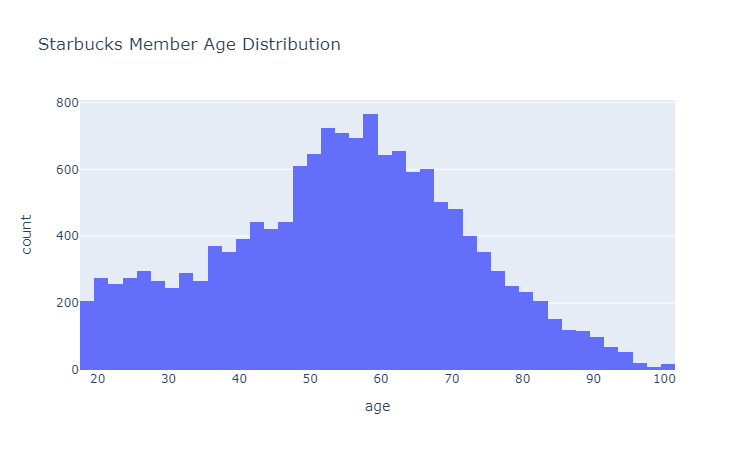

In [19]:
age_dist = px.histogram(profile, x='age', title='Starbucks Member Age Distribution',nbins=50)
age_dist.show()



### Box plot
The Time in Hours Until Event Occurred Since Start of Data Collection

This box plot displays time distribution of customers until an even occurred. There were mainly two types of events included in the dataset, which are 'Offer Completed' and 'Transaction'. Therefore, this box plot indicates when customers visited Starbucks, either online or offline, and made payments. The beginning of data collection time was set to time=0, and it ranges up to more than 700 hours. The dataset shows that the median transaction time was 408 hours, and the 1st and 3rd quantiles range from 186 hours to 528 hours. 

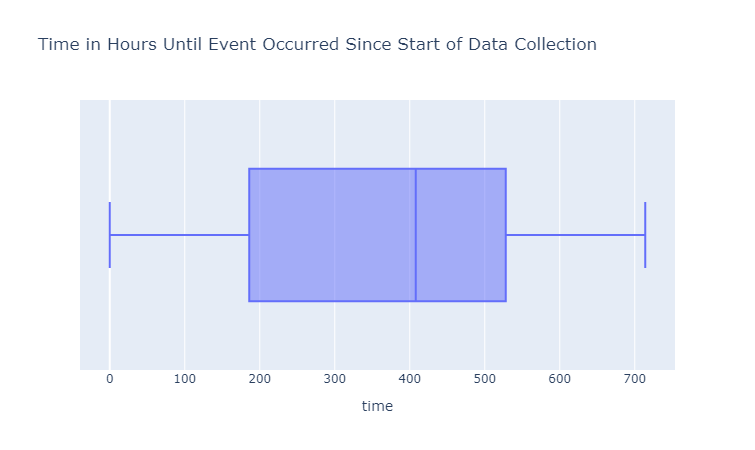

In [20]:
time_box = px.box(combined_data['time'],
             x='time',
             orientation='h',
             title='Time in Hours Until Event Occurred Since Start of Data Collection')
time_box.show()

### Pie Chart : Starbucks Offer Usage Breakdown

More than half(56.3%) of Starbucks customers did not use any offers. The most used offer was buy-one-get-one(bogo) coupon at 18.3%, closely followed by discount coupons at 17%, and lastly, informational offers at 8.5%.

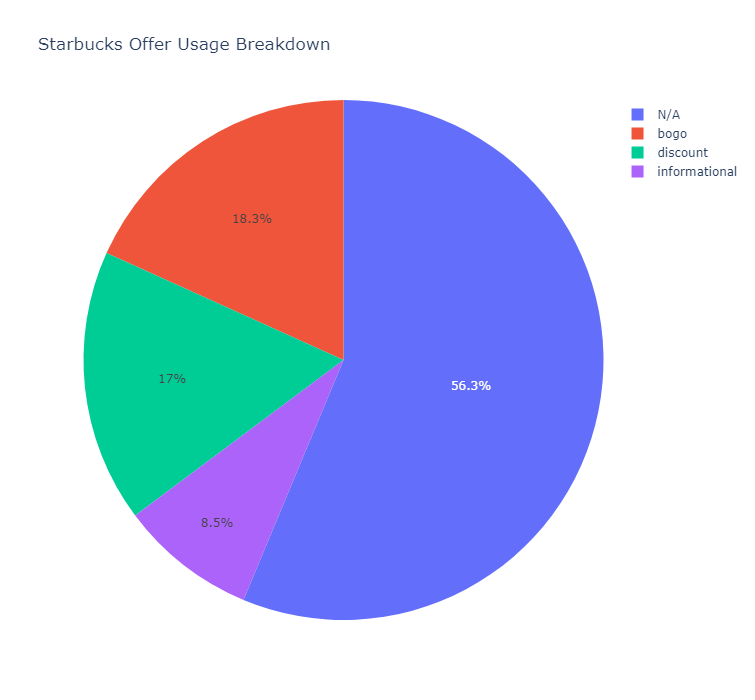

In [21]:
offer_pie = px.pie(
    combined_data,
    names='offer_type',
    title='Starbucks Offer Usage Breakdown',
    width=800,
    height=700
)

offer_pie.show()

### Scatter Plot: Amount of Money Spent by Age Based on Gender

The Mid-high age group tends to spend more than the younger age group according to the scatter plot. In the scatter plot, a lot of data are not showing the correct trends of spending by age due to extreme values above $200. Therefore, the scatter plot would show more accurate information if we exclude outliers with high amount.

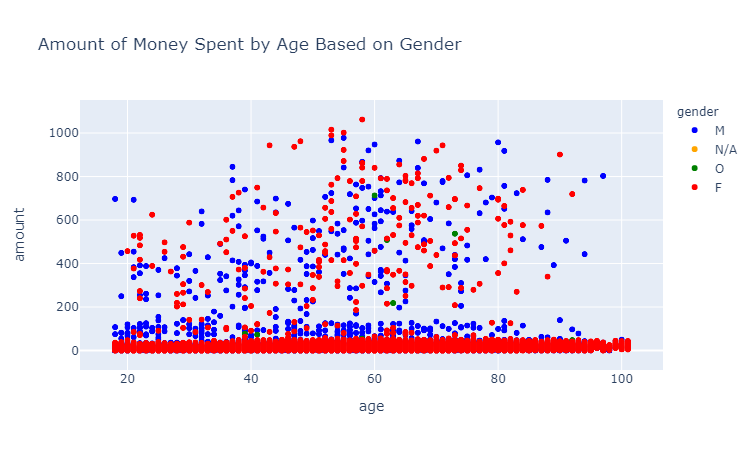

In [22]:
gender_scatter = px.scatter(combined_data,
                 x='age',
                 y='amount',
                 color='gender',
                 color_discrete_map={'M': 'blue','F': 'red', 'O': 'green', 'N/A': 'orange'},
                 title='Amount of Money Spent by Age Based on Gender')

gender_scatter.show()


### Pie Chart: Starbucks Event Breakdown

Almost half of the Starbucks customers are going through transactions(45.3%), 24.9% only received offers but did not respond, 18.8% viewed offers, and only 11% actually completed using the offers they received. 

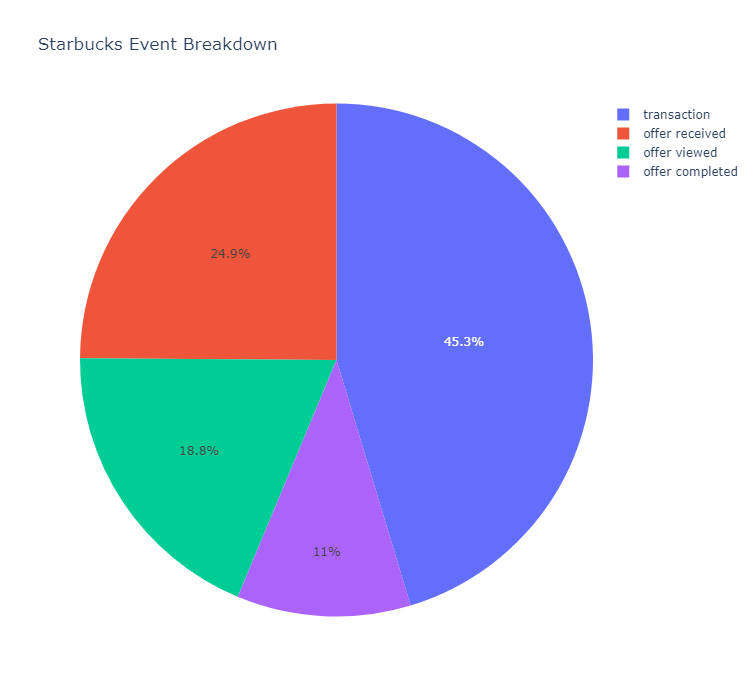

In [23]:
event_pie = px.pie(
    combined_data,
    names='event',
    title='Starbucks Event Breakdown',
    width=800,
    height=700
)

event_pie.show()